### Importing Libraries needed for this project

In [36]:
#Fundametal Libraries for any project
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import pandas_profiling

#sklearn for modelling
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LinearRegression
from sklearn.svm import SVR

#Web-based EDA for curiosity purposes
from shapash.explainer.smart_explainer import SmartExplainer

#Metrics
from sklearn import metrics
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import cross_val_score
from sklearn.metrics import confusion_matrix,plot_confusion_matrix

### Importing Data into python

In [18]:
df = pd.read_csv('credit.csv', header=0) #Fetching clean data
pd.set_option('max_columns', None)

### Getting rid of the negative values in Bills and Payments as well as any duplicates

In [19]:
df = df.drop_duplicates()
num = df.iloc[:,11:23]._get_numeric_data()
num[num < 0] = 0    

### Intial EDA - Pandas Profiling

In [20]:
df.describe()
pandas_profiling.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Making my own EDA

 #### Defining a function to call back


In [21]:
def EDA_Plots(df) :  
    fig, axes = plt.subplots(2,4,figsize = (25,11))

    x = df.loc[df.BILL_AMT1 > 0]
    x2 = df.loc[df.BILL_AMT2 > 0]
    x3 = df.loc[df.BILL_AMT3 > 0]
    x4 = df.loc[df.PAY_AMT1 > 0]
    x5 = df.loc[df.PAY_AMT2 > 0]
    x6 = df.loc[df.PAY_AMT3 > 0]

    sns.set_theme(style="darkgrid")
    
    #First Histogram
    sns.histplot(data=x, x=x["BILL_AMT1"], bins=12, log_scale=True, fill=False, label="Sept",ax=axes[0,0])
    sns.histplot(data=x2, x=x2["BILL_AMT2"], bins=12, log_scale=True, fill=False,label="Aug",ax=axes[0,0])
    sns.histplot(data=x3, x=x3["BILL_AMT3"], bins=12, log_scale=True, fill=False,label="July",ax=axes[0,0])
    axes[0,0].set_title("Amount Billed in the past 3 Months")
    axes[0,0].set_xlabel("Bill Amount ($)")
    axes[0,0].legend()
    
    #Second Histogram
    sns.histplot(data=x4, x=x4["PAY_AMT1"], bins=12, log_scale=True, fill=False, label="Sept",ax=axes[1,0])
    sns.histplot(data=x5, x=x5["PAY_AMT2"], bins=12, log_scale=True, fill=False,label="Aug",ax=axes[1,0])
    sns.histplot(data=x6, x=x6["PAY_AMT3"], bins=12, log_scale=True, fill=False,label="July",ax=axes[1,0])
    axes[1,0].set_title("Amount Payed in the past 3 Months")
    axes[1,0].set_xlabel("Payment Amount ($)")
    axes[1,0].legend()

    #Scatter Plots
    sns.regplot(data=x, x=x["BILL_AMT1"], y=x["LIMIT_BAL"],ax=axes[0,1],scatter_kws={'alpha':0.15},fit_reg=False)
    sns.regplot(data=x2, x=x2["BILL_AMT1"], y=x2["LIMIT_BAL"],ax=axes[0,2],scatter_kws={'alpha':0.15},fit_reg=False)
    sns.regplot(data=x3, x=x3["BILL_AMT1"], y=x3["LIMIT_BAL"],ax=axes[0,3],scatter_kws={'alpha':0.15},fit_reg=False)
    sns.regplot(data=x4, x=x4["PAY_AMT1"], y=x4["LIMIT_BAL"],ax=axes[1,1],scatter_kws={'alpha':0.15},fit_reg=False)
    sns.regplot(data=x5, x=x5["PAY_AMT2"], y=x5["LIMIT_BAL"],ax=axes[1,2],scatter_kws={'alpha':0.15},fit_reg=False)
    sns.regplot(data=x6, x=x6["PAY_AMT3"], y=x6["LIMIT_BAL"],ax=axes[1,3],scatter_kws={'alpha':0.15},fit_reg=False)
    
    axes[0,1].set_title("Amount Billed vs Credit Given")
    axes[0,1].set_xlabel("Bill Sept ($)")
    axes[0,1].set_ylabel("Credit Given")
    #axes[1].set(xscale='log', yscale='log')
    axes[0,2].set_title("Amount Billed vs Credit Given")
    axes[0,2].set_xlabel("Bill Aug ($)")
    axes[0,2].set_ylabel("Credit Given")
    
    axes[0,3].set_title("Amount Billed vs Credit Given")
    axes[0,3].set_xlabel("Bill July ($)")
    axes[0,3].set_ylabel("Credit Given")
    
    axes[1,1].set_title("Amount Payed vs Credit Given")
    axes[1,1].set_xlabel("Pay Sept ($)")
    axes[1,1].set_ylabel("Credit Given")
    
    axes[1,2].set_title("Amount Payed vs Credit Given")
    axes[1,2].set_xlabel("Pay Aug ($)")
    axes[1,2].set_ylabel("Credit Given")
    
    axes[1,3].set_title("Amount Payed vs Credit Given")
    axes[1,3].set_xlabel("Pay July ($)")
    axes[1,3].set_ylabel("Credit Given")

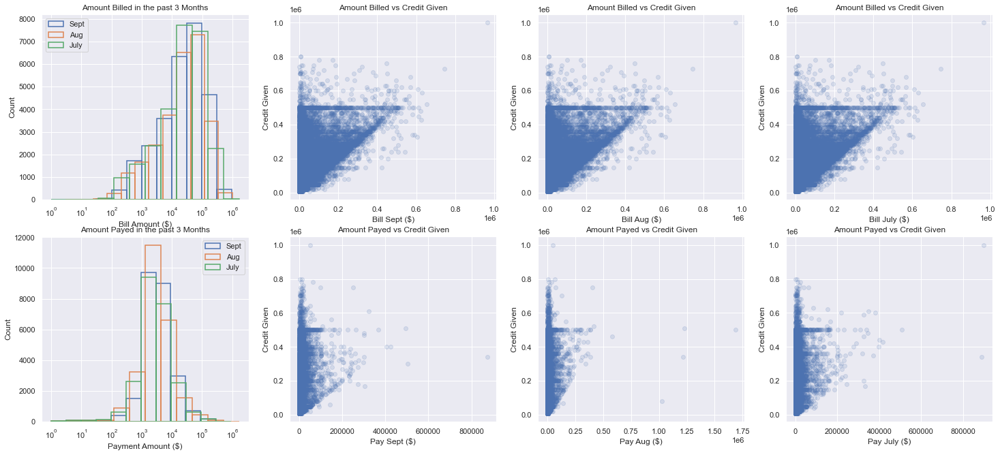

In [11]:
EDA_Plots(df)

### **Short Analysis**

Seems to me that something weird is happening with credit values of 500,000 dollars, for the last three bills it has multiple bill values corresponding to the same 500,000 credit value. This would hinder the accuracy of our model as it tries to correlate Bill Amount with Limit Balance. To avoid this, I will not take into credit score values around 500,000 and check weather my correlation improves.

### Creating New Data Set

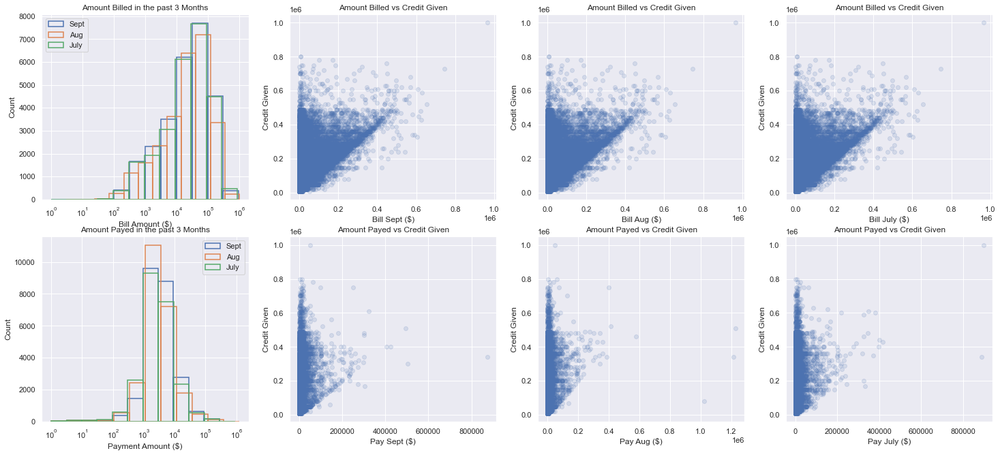

In [22]:
drops = df[(df.LIMIT_BAL != 500000)]
EDA_Plots(drops)

### **Short Analysis**

So this just dropped all values at 500,000 Credit taking it as outlayers, however it might not be the best way to do this.

### Creating Box Plots to see distribution

(1, 10000000)

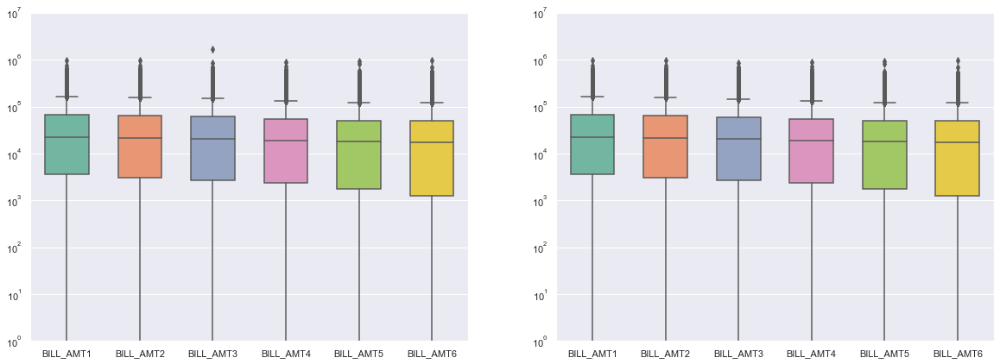

In [23]:
Bills = df[['BILL_AMT1','BILL_AMT2','BILL_AMT3','BILL_AMT4','BILL_AMT5','BILL_AMT6']]
Bills2 = drops[['BILL_AMT1','BILL_AMT2','BILL_AMT3','BILL_AMT4','BILL_AMT5','BILL_AMT6']]
fig, ax = plt.subplots(1,2,figsize = (20,7))
sns.boxplot(data=Bills, width=0.6, ax=ax[0],palette="Set2",)
sns.boxplot(data=Bills2, width=0.6, ax=ax[1],palette="Set2",)
ax[0].set_yscale('log')
ax[1].set_yscale('log')
ax[0].set_ylim(1,10000000)
ax[1].set_ylim(1,10000000)

### **Short Analysis**

Note that the box plots are in log scale, meaning their IQR spans a plethora of values. Also, the multiple points above the maximum line of the box plot shows the possibility of many anomalies in the data, more data cleaning must be done.

### Attempting to use IQR to clean Data

In [24]:
Q1 = num.quantile(0.25)
Q3 = num.quantile(0.75)
IQR = Q3 - Q1

IQR_clean = num[(num > (Q1 - 1.5 * IQR)) & (num < (Q3 + 1.5 * IQR))]
IQR_clean = IQR_clean.dropna()

CatData = df[['LIMIT_BAL','SEX','EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0', 'PAY_2', 'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'default payment next month']]
df_IQR =  CatData.merge(IQR_clean, right_index = True, left_index = True)

In [25]:
df_IQR

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,default payment next month,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6
0,20000,0,3,1,24,2,2,-1,-1,-2,-2,0,3913.0,3102.0,689.0,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0
1,120000,0,3,2,26,-1,2,0,0,0,2,0,2682.0,1725.0,2682.0,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0
2,90000,0,3,2,34,0,0,0,0,0,0,1,29239.0,14027.0,13559.0,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0
3,50000,0,3,1,37,0,0,0,0,0,0,1,46990.0,48233.0,49291.0,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0
5,50000,1,0,2,37,0,0,0,0,0,0,1,64400.0,57069.0,57608.0,19394.0,19619.0,20024.0,2500.0,1815.0,657.0,1000.0,1000.0,800.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30192,210000,1,3,1,34,3,2,2,2,2,2,0,2500.0,2500.0,2500.0,2500.0,2500.0,2500.0,0.0,0.0,0.0,0.0,0.0,0.0
30193,10000,1,1,1,43,0,0,0,-2,-2,-2,1,8802.0,10400.0,0.0,0.0,0.0,0.0,2000.0,0.0,0.0,0.0,0.0,0.0
30195,80000,1,3,2,34,2,2,2,2,2,2,0,72557.0,77708.0,79384.0,77519.0,82607.0,81158.0,7000.0,3500.0,0.0,7000.0,0.0,4000.0
30197,150000,1,1,2,43,-1,-1,-1,-1,0,0,1,1683.0,1828.0,3502.0,8979.0,5190.0,0.0,1837.0,3526.0,8998.0,129.0,0.0,0.0


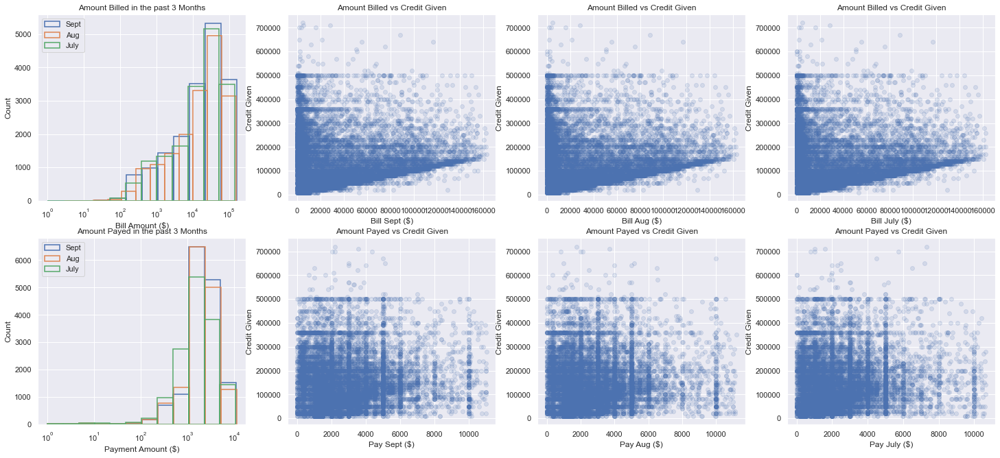

In [26]:
EDA_Plots(df_IQR)

### **Short Analysis**

Experiment of trying to use the IQR method to detect and remove outliers failed. Nearly a third of the data was removed and the graphs look even more random than before. It is my profesional opinion that the best course of action is to remove the data from the 500,000 credit score and continue with the RadomForest algorithm to generate an accurate model to predict whether a customer will default or not, and how much credit to give a new customer.

### Attempting Different approach using correlations and simple demographics

<AxesSubplot:>

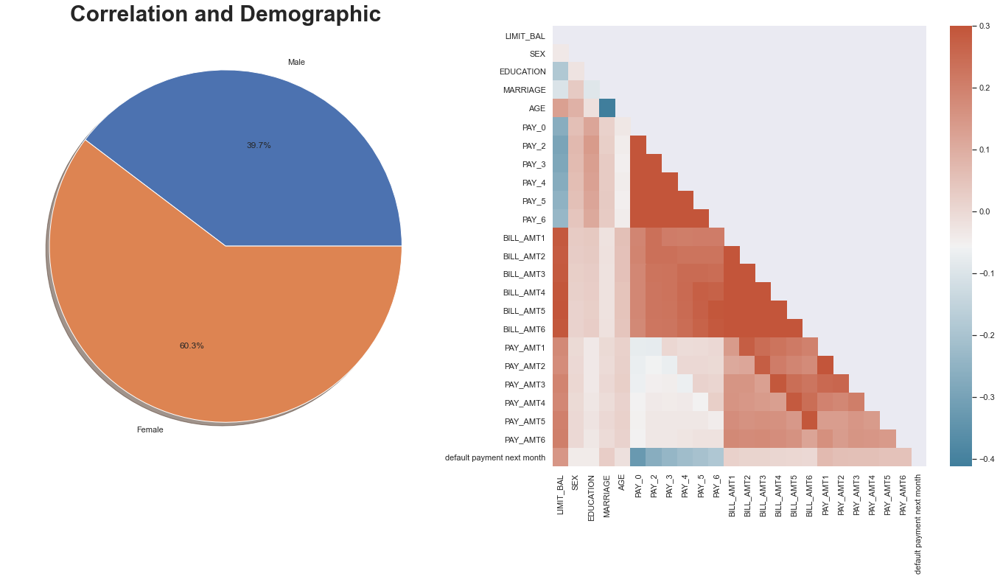

In [34]:
corr = drops.corr()
mask = np.triu(np.ones_like(corr, dtype = bool))
cmap = sns. diverging_palette(230,20, as_cmap=True)

fig, axes = plt.subplots(1,2,figsize = (25,11))
values = [11984, 18217]
my_labels = 'Male', 'Female'
axes[0].pie(values, labels = my_labels, autopct='%1.1f%%', shadow=True)
axes[0].set_title('Correlation and Demographic', fontweight='bold', fontsize = 30)

sns.heatmap(corr, mask=mask, cmap=cmap, vmax=0.3, ax = axes[1])

### **Short Analysis**

It is clear that there are more females than males and therefore i need to be careful when constructing my model to not be biased towards females. Furthermore, using the correlation heatmap, it is clear to see some strong correlation between Bill Amounts for past months and Payment Status, however it is not as clean cut for correlating any feature to the default status of a customer. This is why machine learning and modelling is vital for this task.

I could continue to perfom EDAs to get a feel of the data, but i believe modelling is a good next step after this brief analysis and overview of the data.

## Modelling using Random Forest Regression and Calissfier

Aim is to predict whether a user will default or not to pay the next month.

In [37]:
y1 = df['default payment next month']
X1= df[df.columns.difference(['default payment next month','LIMIT_BAL'])]

y2 = drops['default payment next month']
X2= drops[drops.columns.difference(['default payment next month','LIMIT_BAL'])]

X1_train, X1_test, y1_train, y1_test = train_test_split(X1, y1, test_size=0.20, random_state=123)
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.20, random_state=123)

rfr = RandomForestRegressor(n_estimators=200, n_jobs=2, random_state=0)
lr = LinearRegression(fit_intercept=True, n_jobs=2)
svr = SVR()
rfc = RandomForestClassifier(n_estimators=200, n_jobs=2, random_state=0)

df_rfr_model = rfr.fit(X1_train, y1_train.values.ravel())
df_lr_model = lr.fit(X1_train, y1_train.values.ravel())
df_svr_model = svr.fit(X1_train, y1_train.values.ravel())
df_rfc_model = rfc.fit(X1_train, y1_train.values.ravel())

drops_rfr_model = rfr.fit(X2_train, y2_train.values.ravel())
drops_lr_model = lr.fit(X2_train, y2_train.values.ravel())
drops_svr_model = svr.fit(X2_train, y2_train.values.ravel())
drops_rfc_model = rfc.fit(X2_train, y2_train.values.ravel())

### Regressor Model Accuracy/Results

In [38]:
algosClassdf = []
algosClassdrops = []

algosClassdf.append(('Random Forest Regressor - Raw Data:     ',df_rfr_model))
algosClassdf.append(('Linear Regression - Raw Data:           ',df_lr_model))
algosClassdf.append(('Support Vector Regression - Raw Data:   ',df_svr_model))

algosClassdrops.append(('Random Forest Regressor - Drops Data:   ',drops_rfr_model))
algosClassdrops.append(('Linear Regression - Drops Data:         ',drops_lr_model))
algosClassdrops.append(('Support Vector Regression - Drops Data: ',drops_svr_model))

#regression
results = []
names = []
for name, model in algosClassdf:
    result = cross_val_score(model, X1,y1, cv=3, scoring='r2')
    names.append(name)
    results.append(result)
for name, model in algosClassdrops:
    result = cross_val_score(model, X2,y2, cv=3, scoring='r2')
    names.append(name)
    results.append(result)

In [39]:
print('\n')
for i in range(len(names)):
    print(names[i], results[i].mean())



Random Forest Regressor - Raw Data:      0.1724148338953343
Linear Regression - Raw Data:            0.11978273661355528
Support Vector Regression - Raw Data:    -0.08545883185083247
Random Forest Regressor - Drops Data:    0.1698071629739033
Linear Regression - Drops Data:          0.12097041796684878
Support Vector Regression - Drops Data:  -0.08920983139482648


### **Short Analysis**

These results show how accuratly a linear regressor model fits the data. The Raw data refers to the clean data, while Drops data excludes the labels with $500,000 credit balance. The values correspond to the cross validation score mean of 3 folds. The higher the average the better the estimators performance. It is clear to see that a linear model does not fit the data, meaning regression is not the way to tackle this problem, a classifier model is needed.

### Classification Model Accuracy/Results

In [40]:
df_pred = df_rfc_model.predict(X1_test)
drops_pred = drops_rfc_model.predict(X2_test)

ClassifierClass = []

ClassifierClass.append(('Random Forest Classifier - Raw Data - Accuracy:       ', y1_test, df_pred))
ClassifierClass.append(('Random Forest Classifier - Drops Data - Accuracy:     ', y2_test, drops_pred))

results = []
names = []

for name, y_test, prediction in ClassifierClass:
    result = metrics.accuracy_score(y_test, prediction)
    names.append(name)
    results.append(result)

Text(0.5, 1, 'Drops Data')

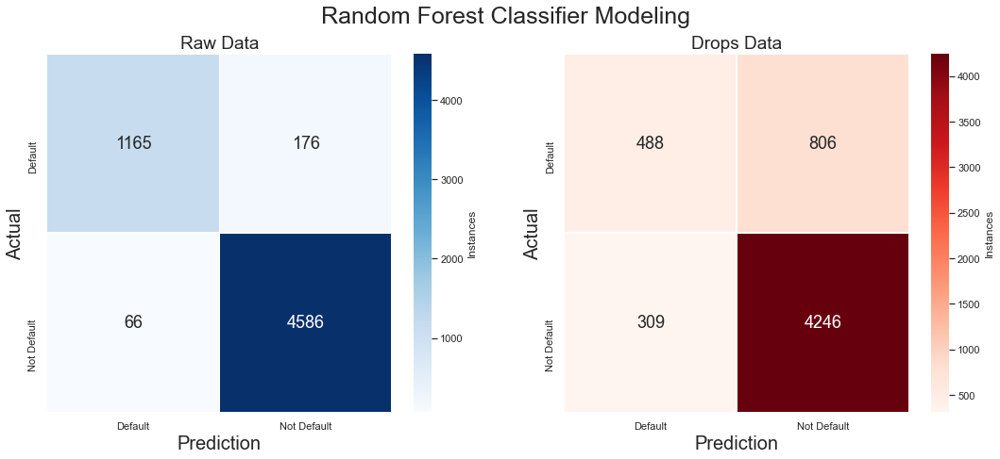

In [42]:
cm1 =confusion_matrix(y1_test, df_pred)
cm2 =confusion_matrix(y2_test, drops_pred)

df_cm1 = pd.DataFrame(cm1, range(2), range(2))
df_cm2 = pd.DataFrame(cm2, range(2), range(2))

#Figure
fig = plt.figure(figsize = (18,7))
ax1 = fig.add_subplot(1, 2, 1)
ax2 = fig.add_subplot(1, 2, 2)

Amount = ['Default', 'Not Default']

sns.heatmap(df_cm1, ax=ax1, xticklabels=Amount, yticklabels=Amount, annot=True,fmt="d", annot_kws={"size": 18},cmap="Blues",linewidths=.5,cbar_kws={'label': 'Instances'})
sns.heatmap(df_cm2, ax=ax2, xticklabels=Amount, yticklabels=Amount, annot=True,fmt="d", annot_kws={"size": 18},cmap="Reds",linewidths=.5,cbar_kws={'label': 'Instances'})

ax1.set_xlabel('Predicted',fontsize=20)
ax1.set_ylabel('Actual',fontsize=20)
ax2.set_xlabel('Predicted',fontsize=20)
ax2.set_ylabel('Actual',fontsize=20)
plt.suptitle('Random Forest Classifier Modeling',fontsize=25)

ax1.set(xlabel='Prediction', ylabel='Actual')
ax1.set_title('Raw Data', y=1, fontsize=19)
ax2.set(xlabel='Prediction', ylabel='Actual')
ax2.set_title('Drops Data', y=1, fontsize=19)

#### Data Importance

In [43]:
for i in range(len(names)):
    print(names[i], results[i].mean())

feature_list = list(X1.columns)
feature_imp = pd.Series(df_rfc_model.feature_importances_, index=feature_list).sort_values(ascending=False)
print('\n','Feature Importance - Raw Data:','\n', feature_imp)

Random Forest Classifier - Raw Data - Accuracy:        0.9596195561488403
Random Forest Classifier - Drops Data - Accuracy:      0.809369122926996

 Feature Importance - Raw Data: 
 PAY_0        0.106014
AGE          0.079852
BILL_AMT1    0.064810
PAY_AMT1     0.056297
BILL_AMT2    0.056136
BILL_AMT3    0.053524
PAY_AMT2     0.052877
BILL_AMT6    0.051941
BILL_AMT4    0.051933
BILL_AMT5    0.051231
PAY_AMT6     0.051074
PAY_AMT3     0.049531
PAY_AMT5     0.047380
PAY_AMT4     0.047358
PAY_2        0.038742
PAY_3        0.030767
PAY_4        0.022488
PAY_5        0.021747
EDUCATION    0.019998
PAY_6        0.018781
MARRIAGE     0.014389
SEX          0.013130
dtype: float64


### **Short Analysis**

Using the Random Forest Classifier there is no doubt that it is the model needed for this project. I can predict with 95% accuracy whether a customer will default or not. Furthermore, I tried experimenting using a second set of data (Drops) which ignores the values of $500,000 credit limit since it looks like an anomoaly in the data, an artificial limit set by the company which I thought would not help the model at all. However, there is a 15% difference between the accuracy of the raw data and the drops data, making the raw data much more accurate. Because of this, i will not exclude any data from the model.

In [44]:
print(df.shape, drops.shape)
print('This is ~1000 labels difference between the Raw data and Drops data')

(29965, 24) (29244, 24)
This is ~1000 labels difference between the Raw data and Drops data


### **Short Bias Analysis**

However, i do have to note that there are considerably more entries of customers not defaulting rather than defaulting, enough to make me question whether my model is being biased towards not defaulting results.

### Predicting Amount Loaned Knowing Default Status

#### Discritizing the limit_balance data to create models

In [45]:
only_not_default = df[(df['default payment next month'] != 1)]
only_default = df[(df['default payment next month'] != 0)]

amount_default = pd.qcut(only_default['LIMIT_BAL'], q=5,labels=[0,1,2,3,4])
amount_not_default = pd.qcut(only_not_default['LIMIT_BAL'], q=5,labels=[0,1,2,3,4])

amount_default.head()

2    1
3    0
4    0
5    0
6    4
Name: LIMIT_BAL, dtype: category
Categories (5, int64): [0 < 1 < 2 < 3 < 4]

In [46]:
pd.qcut(df['LIMIT_BAL'], q=5, precision=0)

0           (9999.0, 50000.0]
1        (100000.0, 180000.0]
2         (50000.0, 100000.0]
3           (9999.0, 50000.0]
4           (9999.0, 50000.0]
                 ...         
30196    (180000.0, 270000.0]
30197    (100000.0, 180000.0]
30198       (9999.0, 50000.0]
30199     (50000.0, 100000.0]
30200       (9999.0, 50000.0]
Name: LIMIT_BAL, Length: 29965, dtype: category
Categories (5, interval[float64]): [(9999.0, 50000.0] < (50000.0, 100000.0] < (100000.0, 180000.0] < (180000.0, 270000.0] < (270000.0, 1000000.0]]

#### Modeling

In [47]:
y = amount_default
y2 = amount_not_default
X = only_default[only_default.columns.difference(['LIMIT_BAL'])]
X2 = only_not_default[only_not_default.columns.difference(['LIMIT_BAL'])]

X1_train, X1_test, y1_train, y1_test = train_test_split(X, y, test_size=0.20, random_state=123)
X2_train, X2_test, y2_train, y2_test = train_test_split(X2, y2, test_size=0.20, random_state=123)

In [48]:
rfc = RandomForestClassifier(n_estimators=200, n_jobs=2, random_state=0)   #.values gives the values in an array of shape (n,1)
default_model = rfc.fit(X1_train, y1_train.values.ravel())     #.ravel() converts array to shape (n,)
not_default_model = rfc.fit(X2_train, y2_train.values.ravel())

In [49]:
default_pred = default_model.predict(X1_test)
not_default_pred = not_default_model.predict(X2_test)

#### Accuracy Scores

In [50]:
print("Accuracy = ", metrics.accuracy_score(y1_test, default_pred))

feature_list = list(X.columns)
feature_imp = pd.Series(default_model.feature_importances_, index=feature_list).sort_values(ascending=False)
feature_imp

Accuracy =  0.35247482322691237


BILL_AMT1                     0.112420
BILL_AMT2                     0.100124
BILL_AMT3                     0.081781
AGE                           0.078065
BILL_AMT6                     0.066590
BILL_AMT4                     0.065585
BILL_AMT5                     0.063256
PAY_AMT6                      0.046154
PAY_AMT5                      0.042467
PAY_AMT2                      0.042259
PAY_AMT1                      0.042185
PAY_AMT3                      0.037973
PAY_AMT4                      0.037759
PAY_3                         0.026701
PAY_2                         0.026546
PAY_0                         0.024062
EDUCATION                     0.023940
PAY_4                         0.019816
PAY_5                         0.017156
PAY_6                         0.016598
MARRIAGE                      0.014453
SEX                           0.014110
default payment next month    0.000000
dtype: float64

In [51]:
print("Accuracy = ", metrics.accuracy_score(y2_test, not_default_pred))

feature_list = list(X.columns)
feature_imp = pd.Series(not_default_model.feature_importances_, index=feature_list).sort_values(ascending=False)
feature_imp

Accuracy =  0.5784313725490197


BILL_AMT1                     0.112420
BILL_AMT2                     0.100124
BILL_AMT3                     0.081781
AGE                           0.078065
BILL_AMT6                     0.066590
BILL_AMT4                     0.065585
BILL_AMT5                     0.063256
PAY_AMT6                      0.046154
PAY_AMT5                      0.042467
PAY_AMT2                      0.042259
PAY_AMT1                      0.042185
PAY_AMT3                      0.037973
PAY_AMT4                      0.037759
PAY_3                         0.026701
PAY_2                         0.026546
PAY_0                         0.024062
EDUCATION                     0.023940
PAY_4                         0.019816
PAY_5                         0.017156
PAY_6                         0.016598
MARRIAGE                      0.014453
SEX                           0.014110
default payment next month    0.000000
dtype: float64

#### Making Confusion Matrix

Text(0.5, 1, 'Not Default')

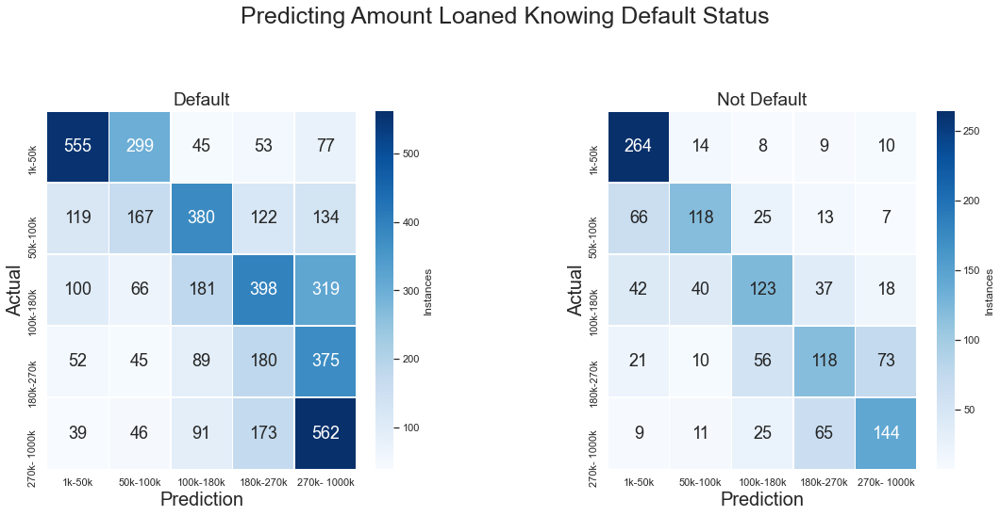

In [55]:
cm1 =confusion_matrix(y1_test, default_pred)
cm2 =confusion_matrix(y2_test, not_default_pred)

df_cm1 = pd.DataFrame(cm1, range(5), range(5))
df_cm2 = pd.DataFrame(cm2, range(5), range(5))

Amount=['1k-50k', '50k-100k', '100k-180k', '180k-270k', '270k- 1000k']

fig = plt.figure(figsize = (18,7)) # width x height
ax1 = fig.add_subplot(1, 2, 1) # row, column, position
ax2 = fig.add_subplot(1, 2, 2)
fig.subplots_adjust(hspace=0.45,wspace=0.45)


sns.heatmap(df_cm1, ax=ax1, xticklabels=Amount, yticklabels=Amount, annot=True,fmt="d", annot_kws={"size": 18},cmap="Blues",linewidths=.5,cbar_kws={'label': 'Instances'}) # font size
sns.heatmap(df_cm2, ax=ax2, xticklabels=Amount, yticklabels=Amount, annot=True,fmt="d", annot_kws={"size": 18},cmap="Blues",linewidths=.5,cbar_kws={'label': 'Instances'}) # font size


ax1.set_xlabel('Predicted',fontsize=20)
ax1.set_ylabel('Actual',fontsize=20)
ax2.set_xlabel('Predicted',fontsize=20)
ax2.set_ylabel('Actual',fontsize=20)
plt.suptitle('Predicting Amount Loaned Knowing Default Status',fontsize=25,y=1.1)

ax1.set(xlabel='Prediction', ylabel='Actual')
ax1.set_title('Default', y=1, fontsize=19)
ax2.set(xlabel='Prediction', ylabel='Actual')
ax2.set_title('Not Default', y=1, fontsize=19)

[Text(0.5, 0, 'Bill Sept'), Text(0, 0.5, 'Limit Balance')]

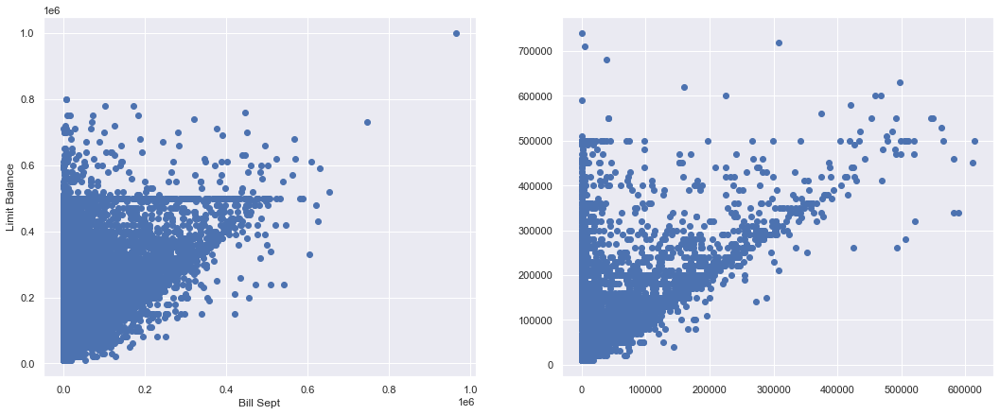

In [56]:
fig = plt.figure(figsize = (18,7))
ax1 = fig.add_subplot(1, 2, 1) # row, column, position
ax2 = fig.add_subplot(1, 2, 2)
ax1.scatter(X['BILL_AMT1'],only_default['LIMIT_BAL'])
ax2.scatter(X2['BILL_AMT1'],only_not_default['LIMIT_BAL'])
ax1.set(xlabel='Bill Sept', ylabel='Limit Balance')

### **Short Analysis

Even if the i tried to improve the data by classifing and cleaning it more than it is, the accuracies are too low as they are.